In [6]:
import geopandas as gpd

# Explorando os dados geográficos

In [7]:
rj = gpd.read_file('dados/rj_setores_censitarios/33SEE250GC_SIR.shp')
rj.head()

,ID,CD_GEOCODI,TIPO,CD_GEOCODB,NM_BAIRRO,CD_GEOCODS,NM_SUBDIST,CD_GEOCODD,NM_DISTRIT,CD_GEOCODM,NM_MUNICIP,NM_MICRO,NM_MESO,geometry
0,43773,330025805000046,URBANO,None,None,33002580500,None,330025805,ARRAIAL DO CABO,3300258,ARRAIAL DO CABO,LAGOS,BAIXADAS,"POLYGON ((-42.01954 -22.96936, -42.02059 -22.9..."
1,43774,330025805000047,URBANO,None,None,33002580500,None,330025805,ARRAIAL DO CABO,3300258,ARRAIAL DO CABO,LAGOS,BAIXADAS,"POLYGON ((-42.02282 -22.96769, -42.02290 -22.9..."
2,43775,330025805000048,URBANO,None,None,33002580500,None,330025805,ARRAIAL DO CABO,3300258,ARRAIAL DO CABO,LAGOS,BAIXADAS,"POLYGON ((-42.16022 -22.94740, -42.16241 -22.9..."
3,43776,330025805000049,URBANO,None,None,33002580500,None,330025805,ARRAIAL DO CABO,3300258,ARRAIAL DO CABO,LAGOS,BAIXADAS,"POLYGON ((-42.17397 -22.94625, -42.17588 -22.9..."
4,43777,330025805000050,URBANO,None,None,33002580500,None,330025805,ARRAIAL DO CABO,3300258,ARRAIAL DO CABO,LAGOS,BAIXADAS,"POLYGON ((-42.17588 -22.94609, -42.17848 -22.9..."


<Axes: >

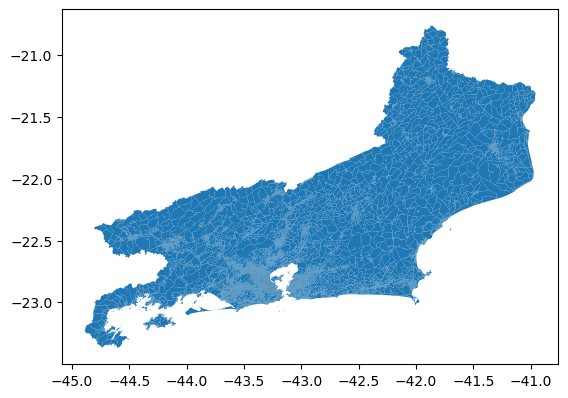

In [8]:
rj.plot()

In [9]:
mask = rj['NM_MUNICIP'] == 'RIO DE JANEIRO'
cidade_rio = rj[mask]
cidade_rio.head()

,ID,CD_GEOCODI,TIPO,CD_GEOCODB,NM_BAIRRO,CD_GEOCODS,NM_SUBDIST,CD_GEOCODD,NM_DISTRIT,CD_GEOCODM,NM_MUNICIP,NM_MICRO,NM_MESO,geometry
10708,56651,330455705080006,URBANO,330455705005,Catumbi,33045570508,RIO COMPRIDO,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO,"POLYGON ((-43.19949 -22.92454, -43.19953 -22.9..."
10709,56652,330455705080007,URBANO,330455705005,Catumbi,33045570508,RIO COMPRIDO,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO,"POLYGON ((-43.19795 -22.91829, -43.19819 -22.9..."
10710,56653,330455705080008,URBANO,330455705005,Catumbi,33045570508,RIO COMPRIDO,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO,"POLYGON ((-43.19858 -22.91876, -43.19888 -22.9..."
10711,56654,330455705080009,URBANO,330455705005,Catumbi,33045570508,RIO COMPRIDO,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO,"POLYGON ((-43.19879 -22.91937, -43.19879 -22.9..."
10712,56655,330455705080010,URBANO,330455705005,Catumbi,33045570508,RIO COMPRIDO,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO,"POLYGON ((-43.19791 -22.92028, -43.19791 -22.9..."


<Axes: >

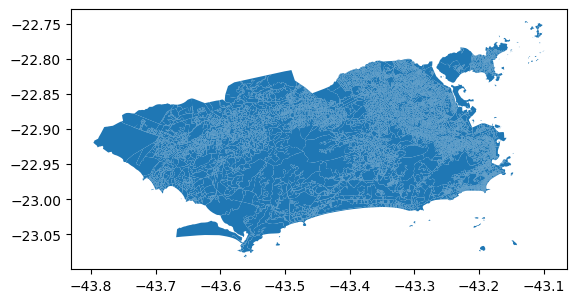

In [10]:
cidade_rio.plot()

In [11]:
import folium

In [12]:
mapa_rio = folium.Map(location = [-22, -43],
                      zoom_start = 8)

mapa_rio

In [13]:
mapa_rio = folium.Map(location = [-22, -43],
                      zoom_start = 8,
                      tiles = 'OpenStreetMap',
                      name = 'OpenStreet')
                                            
mapa_rio

In [14]:
mapa_rio = folium.Map(location = [-22, -43],
                      zoom_start = 8,
                      tiles = 'OpenStreetMap',
                      name = 'OpenStreet')
                                            
folium.TileLayer('cartodbpositron', name = 'Positron').add_to(mapa_rio)
folium.TileLayer('cartodbdark_matter', name = 'Dark').add_to(mapa_rio)
folium.TileLayer('https://{s}.tile-cyclosm.openstreetmap.fr/cyclosm/{z}/{x}/{y}.png', name = 'OSM',
                 attr = '<a href="https://github.com/cyclosm/cyclosm-cartocss-style/releases" title="CyclOSM - Open Bicycle render">CyclOSM</a> | Map data: &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors').add_to(mapa_rio)

folium.LayerControl().add_to(mapa_rio)

mapa_rio.save('mapa_rio.html')

mapa_rio

## Adicionando contornos do munícipio do RJ

In [15]:
bairros_rio = cidade_rio.dissolve(by = 'NM_BAIRRO')
bairros_rio

,geometry,ID,CD_GEOCODI,TIPO,CD_GEOCODB,CD_GEOCODS,NM_SUBDIST,CD_GEOCODD,NM_DISTRIT,CD_GEOCODM,NM_MUNICIP,NM_MICRO,NM_MESO
NM_BAIRRO,,,,,,,,,,,,,
Abolição,"POLYGON ((-43.30094 -22.89123, -43.30095 -22.8...",59926,330455705170481,URBANO,330455705060,33045570517,MÉIER,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO
Acari,"POLYGON ((-43.34222 -22.82782, -43.34253 -22.8...",65174,330455705300052,URBANO,330455705138,33045570530,PAVUNA,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO
Alto da Boa Vista,"POLYGON ((-43.29429 -22.97967, -43.29421 -22.9...",58519,330455705130289,URBANO,330455705031,33045570513,TIJUCA,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO
Anchieta,"POLYGON ((-43.41002 -22.83423, -43.41015 -22.8...",64367,330455705270062,URBANO,330455705125,33045570527,ANCHIETA,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO
Andaraí,"POLYGON ((-43.26797 -22.93775, -43.26729 -22.9...",58716,330455705140165,URBANO,330455705034,33045570514,VILA ISABEL,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO
...,...,...,...,...,...,...,...,...,...,...,...,...,...
Vila Valqueire,"POLYGON ((-43.36708 -22.89711, -43.36718 -22.8...",60902,330455705210219,URBANO,330455705091,33045570521,JACAREPAGUÁ,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO
Vila da Penha,"POLYGON ((-43.31551 -22.84892, -43.31559 -22.8...",60156,330455705190061,URBANO,330455705064,33045570519,IRAJÁ,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO
Vista Alegre,"POLYGON ((-43.31911 -22.83312, -43.31912 -22.8...",60196,330455705190101,URBANO,330455705065,33045570519,IRAJÁ,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO


In [16]:
mapa_rio = folium.Map(location = [-22, -43],
                      zoom_start = 8,
                      tiles = 'cartodbpositron')

folium.GeoJson(bairros_rio).add_to(mapa_rio)

mapa_rio

In [17]:
cidade = cidade_rio.dissolve(by = 'NM_MUNICIP')
cidade

,geometry,ID,CD_GEOCODI,TIPO,CD_GEOCODB,NM_BAIRRO,CD_GEOCODS,NM_SUBDIST,CD_GEOCODD,NM_DISTRIT,CD_GEOCODM,NM_MICRO,NM_MESO
NM_MUNICIP,,,,,,,,,,,,,
RIO DE JANEIRO,"MULTIPOLYGON (((-43.69721 -22.98559, -43.69753...",56651,330455705080006,URBANO,330455705005,Catumbi,33045570508,RIO COMPRIDO,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO


In [18]:
mapa_rio = folium.Map(location = [-22, -43],
                      zoom_start = 8,
                      tiles = 'cartodbpositron')

folium.GeoJson(cidade).add_to(mapa_rio)

mapa_rio

## Adicionando contornos dos subdistritos do RJ

In [25]:
subdistritos_rio = cidade_rio.dissolve(by = 'NM_SUBDIST')
subdistritos_rio.head()

,geometry,ID,CD_GEOCODI,TIPO,CD_GEOCODB,NM_BAIRRO,CD_GEOCODS,CD_GEOCODD,NM_DISTRIT,CD_GEOCODM,NM_MUNICIP,NM_MICRO,NM_MESO
NM_SUBDIST,,,,,,,,,,,,,
ANCHIETA,"POLYGON ((-43.39713 -22.84397, -43.39693 -22.8...",63838,330455705270028,URBANO,330455705124,Guadalupe,33045570527,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO
BANGU,"POLYGON ((-43.50491 -22.88582, -43.50497 -22.8...",62027,330455705220201,URBANO,330455705099,Bangu,33045570522,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO
BARRA DA TIJUCA,"MULTIPOLYGON (((-43.51347 -23.06586, -43.51362...",64722,330455705290104,URBANO,330455705131,Barra da Tijuca,33045570529,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO
BOTAFOGO,"MULTIPOLYGON (((-43.20109 -22.96152, -43.20111...",56835,330455705090055,URBANO,330455705014,Botafogo,33045570509,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO
CAMPO GRANDE,"POLYGON ((-43.62150 -22.92687, -43.62150 -22.9...",60934,330455705230039,URBANO,330455705102,Campo Grande,33045570523,330455705,RIO DE JANEIRO,3304557,RIO DE JANEIRO,RIO DE JANEIRO,METROPOLITANA DO RIO DE JANEIRO


In [26]:
mapa_rio = folium.Map(location = [-22, -43],
                      zoom_start = 8,
                      tiles = 'cartodbpositron')

folium.GeoJson(subdistritos_rio).add_to(mapa_rio)

mapa_rio

In [34]:
import pandas as pd

url = "https://caelum-online-public.s3.amazonaws.com/3061-dados-geograficos-folium/dados.csv"
imoveis = pd.read_csv(url, sep='\t')

imoveis.head()


,Area,Bairro,Cidade,Endereco,Estado,Latitude,Longitude,Quartos,Suites,Vagas,Tipo,Transacao,Valor
0,138,Recreio dos Bandeirantes,Rio de Janeiro,Rua Vicente Scofano,RJ,-23.016455,-43.462946,3,1,3,Apartamento,Venda,1095000
1,133,Freguesia (Jacarepaguá),Rio de Janeiro,Rua Potiguara,RJ,-22.943199,-43.336911,3,1,2,Apartamento,Venda,650000
2,46,Pilares,Rio de Janeiro,Rua Professor Carneiro Felipe,RJ,-22.873849,-43.300517,1,0,0,Apartamento,Venda,150000
3,65,Barra da Tijuca,Rio de Janeiro,Avenida Salvador Allende,RJ,-22.984787,-43.412703,2,1,1,Apartamento,Venda,430000
4,85,Gávea,Rio de Janeiro,Rua Marquês de São Vicente,RJ,-14.235004,-51.925280,2,1,2,Apartamento,Venda,1800000


In [36]:
imoveis = gpd.GeoDataFrame(imoveis, geometry = gpd.points_from_xy(imoveis['Longitude'], imoveis['Latitude']))
imoveis.head()

,Area,Bairro,Cidade,Endereco,Estado,Latitude,Longitude,Quartos,Suites,Vagas,Tipo,Transacao,Valor,geometry
0,138,Recreio dos Bandeirantes,Rio de Janeiro,Rua Vicente Scofano,RJ,-23.016455,-43.462946,3,1,3,Apartamento,Venda,1095000,POINT (-43.46295 -23.01646)
1,133,Freguesia (Jacarepaguá),Rio de Janeiro,Rua Potiguara,RJ,-22.943199,-43.336911,3,1,2,Apartamento,Venda,650000,POINT (-43.33691 -22.94320)
2,46,Pilares,Rio de Janeiro,Rua Professor Carneiro Felipe,RJ,-22.873849,-43.300517,1,0,0,Apartamento,Venda,150000,POINT (-43.30052 -22.87385)
3,65,Barra da Tijuca,Rio de Janeiro,Avenida Salvador Allende,RJ,-22.984787,-43.412703,2,1,1,Apartamento,Venda,430000,POINT (-43.41270 -22.98479)
4,85,Gávea,Rio de Janeiro,Rua Marquês de São Vicente,RJ,-14.235004,-51.925280,2,1,2,Apartamento,Venda,1800000,POINT (-51.92528 -14.23500)


<Axes: >

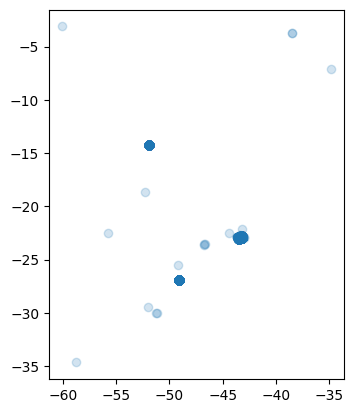

In [37]:
base = cidade.plot()
imoveis.plot(ax = base, alpha = 0.2)

Necessário filtrar os pontos para que eles estejam apenas inseridos no RJ

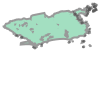

In [38]:
cidade['geometry'].iloc[0]

In [39]:
mask = imoveis['geometry'].within(cidade['geometry'].iloc[0])
mask

0        True
1        True
2        True
3        True
4       False
        ...  
4995     True
4996     True
4997     True
4998     True
4999     True
Length: 5000, dtype: bool

In [40]:
imoveis = imoveis[mask]

<Axes: >

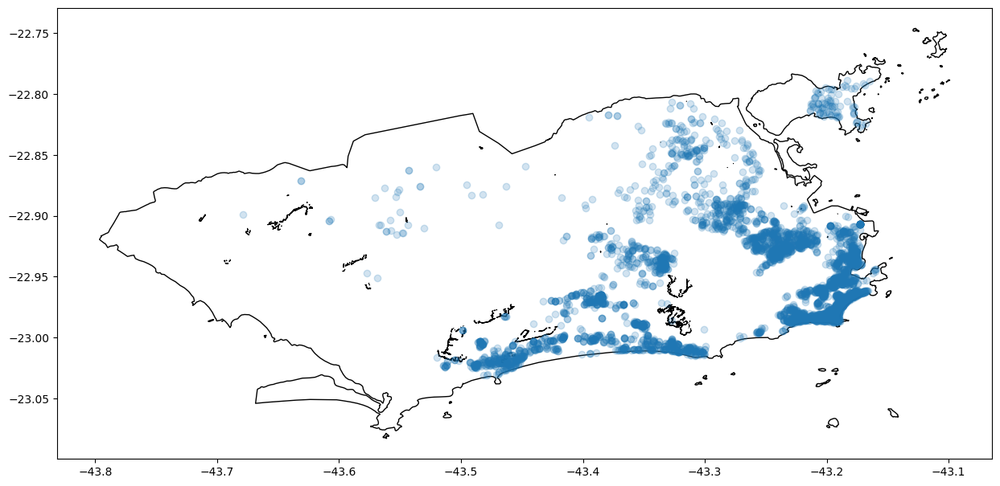

In [41]:
base = cidade.plot(color = 'white', edgecolor = 'black', figsize = (15,8))
imoveis.plot(ax = base, alpha = 0.2)

## Adicionando mapa de calor

In [42]:
from folium.plugins import HeatMap

In [43]:
mapa_rio = folium.Map(location = [imoveis['Latitude'].mean(), imoveis['Longitude'].mean()],
                      zoom_start = 10,
                      tiles = 'cartodbpositron')

HeatMap(data = imoveis[['Latitude', 'Longitude']]).add_to(mapa_rio)

mapa_rio

In [44]:
mapa_rio = folium.Map(location = [imoveis['Latitude'].mean(), imoveis['Longitude'].mean()],
                      zoom_start = 10,
                      tiles = 'cartodbpositron')

HeatMap(data = imoveis[['Latitude', 'Longitude']], name = 'Mapa de Calor').add_to(mapa_rio)
folium.GeoJson(cidade, name = 'Rio de Janeiro').add_to(mapa_rio)

folium.LayerControl().add_to(mapa_rio)

mapa_rio

In [45]:
mapa_rio = folium.Map(location = [imoveis['Latitude'].mean(), imoveis['Longitude'].mean()],
                      zoom_start = 10,
                      tiles = 'cartodbdark_matter')

estilo = {'fillOpacity':0 ,'color' : '#ffffff', 'weight': 0.5}

HeatMap(data = imoveis[['Latitude', 'Longitude']], name = 'Mapa de Calor', radius = 20).add_to(mapa_rio)
folium.GeoJson(cidade, name = 'Rio de Janeiro', style_function= lambda x: estilo).add_to(mapa_rio)

folium.LayerControl().add_to(mapa_rio)

mapa_rio

In [47]:
mapa_rio = folium.Map(location = [imoveis['Latitude'].mean(), imoveis['Longitude'].mean()],
                      zoom_start = 10,
                      tiles = 'cartodbdark_matter',
                      name = 'Dark')

estilo_borda_branca = {'fillOpacity':0 ,'color' : '#ffffff', 'weight': 0.5}

HeatMap(data = imoveis[['Latitude', 'Longitude']], name = 'Mapa de Calor', radius = 20).add_to(mapa_rio)
folium.GeoJson(bairros_rio, name = 'Rio de Janeiro', style_function= lambda x: estilo_borda_branca).add_to(mapa_rio)

estilo_borda_preta = {'fillOpacity':0 ,'color' : '#000000', 'weight': 0.5}

HeatMap(data = imoveis[['Latitude', 'Longitude']], name = 'Mapa de Calor (vemelho)', radius = 20, gradient = {0:'grey', 1:'red'}, show = False).add_to(mapa_rio)
folium.GeoJson(bairros_rio, name = 'Rio de Janeiro (borda preta)', style_function= lambda x: estilo_borda_preta, show = False).add_to(mapa_rio)

folium.TileLayer('cartodbpositron', name = 'Positron', show = False).add_to(mapa_rio)

folium.LayerControl().add_to(mapa_rio)

mapa_rio

## Adicionando identificação por bairro

In [48]:
bairros_rio.crs

<Geographic 2D CRS: EPSG:4674>
Name: SIRGAS 2000
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: Latin America - Central America and South America - onshore and offshore. Brazil - onshore and offshore.
- bounds: (-122.19, -59.87, -25.28, 32.72)
Datum: Sistema de Referencia Geocentrico para las AmericaS 2000
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [49]:
mapa_rio = folium.Map(location = [imoveis['Latitude'].mean(), imoveis['Longitude'].mean()],
                      zoom_start = 10,
                      tiles = 'cartodbdark_matter')

estilo = {'fillOpacity':0 ,'color' : '#ffffff', 'weight': 0.5}

HeatMap(data = imoveis[['Latitude', 'Longitude']], name = 'Mapa de Calor', radius = 20).add_to(mapa_rio)

for indice, linha in bairros_rio.iterrows():
    bairro = gpd.GeoDataFrame(pd.DataFrame(linha).T, geometry= 'geometry', crs = 'EPSG:4674')
    folium.GeoJson(bairro, name = bairro.index[0], style_function= lambda x: estilo, tooltip = bairro.index[0]).add_to(mapa_rio)

folium.LayerControl().add_to(mapa_rio)

mapa_rio.save('mapa_calor_rio.html')

mapa_rio

# Análise detalhada

## Adicionando marcadores

In [50]:
mapa_rio = folium.Map(location = [imoveis['Latitude'].mean(), imoveis['Longitude'].mean()],
                      zoom_start = 10,
                      tiles = 'cartodbpositron')

folium.GeoJson(cidade, name = 'Rio de Janeiro').add_to(mapa_rio)

amostra_imoveis = imoveis.sample(500)

amostra_imoveis.apply(
    lambda linha: folium.Marker(
        location = [linha['Latitude'],
                    linha['Longitude']]
    ).add_to(mapa_rio), axis = 1
)

folium.LayerControl().add_to(mapa_rio)

mapa_rio

In [51]:
mapa_rio = folium.Map(location = [imoveis['Latitude'].mean(), imoveis['Longitude'].mean()],
                      zoom_start = 10,
                      tiles = 'cartodbpositron')

folium.GeoJson(cidade, name = 'Rio de Janeiro').add_to(mapa_rio)

amostra_imoveis = imoveis.sample(500)

amostra_imoveis.apply(
    lambda linha: folium.Marker(
        location = [linha['Latitude'],
                    linha['Longitude']],
        icon = folium.Icon(color = 'red')
    ).add_to(mapa_rio), axis = 1
)

folium.LayerControl().add_to(mapa_rio)

mapa_rio

## Classificar imóveis por preço

In [52]:
imoveis.describe()

,Area,Latitude,Longitude,Quartos,Suites,Vagas,Valor
count,4513.000000,4513.000000,4513.000000,4513.000000,4513.000000,4513.000000,4.513000e+03
mean,121.512076,-22.952875,-43.275193,2.617771,0.925105,1.222025,1.382456e+06
std,88.566429,0.046873,0.094642,0.902083,0.922614,0.907701,1.841276e+06
min,15.000000,-23.031084,-43.678834,0.000000,0.000000,0.000000,8.000000e+04
25%,70.000000,-22.985222,-43.343578,2.000000,0.000000,1.000000,4.500000e+05
50%,92.000000,-22.963529,-43.238239,3.000000,1.000000,1.000000,8.000000e+05
75%,143.000000,-22.924173,-43.194280,3.000000,1.000000,2.000000,1.560000e+06
max,1147.000000,-22.788539,-43.159735,12.000000,5.000000,6.000000,3.000000e+07


In [53]:
imoveis.insert(0, 'cor', pd.qcut(imoveis['Valor'], q = [0, 0.5, 0.75, 1], labels = ['green', 'orange', 'red']))

In [54]:
mapa_rio = folium.Map(location = [imoveis['Latitude'].mean(), imoveis['Longitude'].mean()],
                      zoom_start = 10,
                      tiles = 'cartodbpositron')

folium.GeoJson(cidade, name = 'Rio de Janeiro').add_to(mapa_rio)

amostra_imoveis = imoveis.sample(500)

amostra_imoveis.apply(
    lambda linha: folium.Marker(
        location = [linha['Latitude'],
                    linha['Longitude']],
        icon = folium.Icon(color = linha['cor'], icon = 'fa-home', prefix = 'fa')
    ).add_to(mapa_rio), axis = 1
)

folium.LayerControl().add_to(mapa_rio)

mapa_rio

In [55]:
mapa_rio = folium.Map(location = [imoveis['Latitude'].mean(), imoveis['Longitude'].mean()],
                      zoom_start = 10,
                      tiles = 'cartodbpositron')

estilo = {'fillOpacity':0 ,'color' : '#000000', 'weight': 0.5}

for indice, linha in bairros_rio.iterrows():
    bairro = gpd.GeoDataFrame(pd.DataFrame(linha).T, geometry= 'geometry', crs = 'EPSG:4674')
    folium.GeoJson(bairro, name = bairro.index[0], style_function= lambda x: estilo, tooltip = bairro.index[0]).add_to(mapa_rio)

amostra_imoveis = imoveis.sample(500)

amostra_imoveis.apply(
    lambda linha: folium.Marker(
        location = [linha['Latitude'],
                    linha['Longitude']],
        icon = folium.Icon(color = linha['cor'], icon = 'fa-home', prefix = 'fa')
    ).add_to(mapa_rio), axis = 1
)

folium.LayerControl().add_to(mapa_rio)

mapa_rio

In [57]:
mapa_rio = folium.Map(location = [imoveis['Latitude'].mean(), imoveis['Longitude'].mean()],
                      zoom_start = 10,
                      tiles = 'cartodbpositron')

estilo = {'fillOpacity':0 ,'color' : '#000000', 'weight': 0.5}

for indice, linha in bairros_rio.iterrows():
    bairro = gpd.GeoDataFrame(pd.DataFrame(linha).T, geometry= 'geometry', crs = 'EPSG:4674')
    folium.GeoJson(bairro, name = bairro.index[0], style_function= lambda x: estilo, tooltip = bairro.index[0]).add_to(mapa_rio)

amostra_imoveis = imoveis.sample(500)

amostra_imoveis.apply(
    lambda linha: folium.Marker(
        location = [linha['Latitude'],
                    linha['Longitude']],
        icon = folium.Icon(color = linha['cor'], icon = 'fa-home', prefix = 'fa'),
        popup = f'Área: {linha["Area"]} m², Valor: R$ {linha["Valor"]}'
    ).add_to(mapa_rio), axis = 1
)

folium.LayerControl().add_to(mapa_rio)

mapa_rio

In [62]:
mapa_rio = folium.Map(location = [imoveis['Latitude'].mean(), imoveis['Longitude'].mean()],
                      zoom_start = 10,
                      tiles = 'cartodbpositron')

estilo = {'fillOpacity':0 ,'color' : '#000000', 'weight': 0.5}

for indice, linha in bairros_rio.iterrows():
    bairro = gpd.GeoDataFrame(pd.DataFrame(linha).T, geometry= 'geometry', crs = 'EPSG:4674')
    folium.GeoJson(bairro, name = bairro.index[0], style_function= lambda x: estilo, tooltip = bairro.index[0]).add_to(mapa_rio)

amostra_imoveis = imoveis.sample(500)

amostra_imoveis.apply(
    lambda linha: folium.Marker(
        location = [linha['Latitude'],
                    linha['Longitude']],
        icon = folium.Icon(color = linha['cor'], icon = 'fa-home', prefix = 'fa'),
        popup = folium.Popup(f'''<b>Bairro</b>: {linha["Bairro"]}<br>
                                <b>Área</b>: {linha["Area"]} m²<br>
                                <b>Valor</b>: R$ {linha["Valor"]},00<br>
                                <b>Quartos</b>: {linha["Quartos"]}
                            ''',
                            max_width = 200,
                            sticky = True)
    ).add_to(mapa_rio), axis = 1
)

folium.LayerControl().add_to(mapa_rio)

mapa_rio